In [ ]:
# Required imports
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

In [ ]:

import random
from PIL import Image
from tqdm import tqdm
#from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.optimizers import Adam

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
base_dir = "/content/drive/MyDrive/damaged_and_undamaged_datasets/AI_for_Art_Restoration_2/paired_dataset_art"
damaged_path = os.path.join(base_dir, "damaged")
undamaged_path = os.path.join(base_dir, "undamaged")

In [ ]:
damaged_files = [f for f in os.listdir(damaged_path) if "before" in f.lower()]
undamaged_files = [f for f in os.listdir(undamaged_path) if "after" in f.lower()]

In [ ]:
def get_base_name(filename):
    return filename.lower().replace("before", "").replace("after", "").replace("_", "").replace("-", "").replace(".png", "").strip()

damaged_map = {get_base_name(f): f for f in damaged_files}
undamaged_map = {get_base_name(f): f for f in undamaged_files}

common_keys = list(set(damaged_map.keys()) & set(undamaged_map.keys()))
print(f"✅ Matched {len(common_keys)} before–after image pairs.")

✅ Matched 111 before–after image pairs.


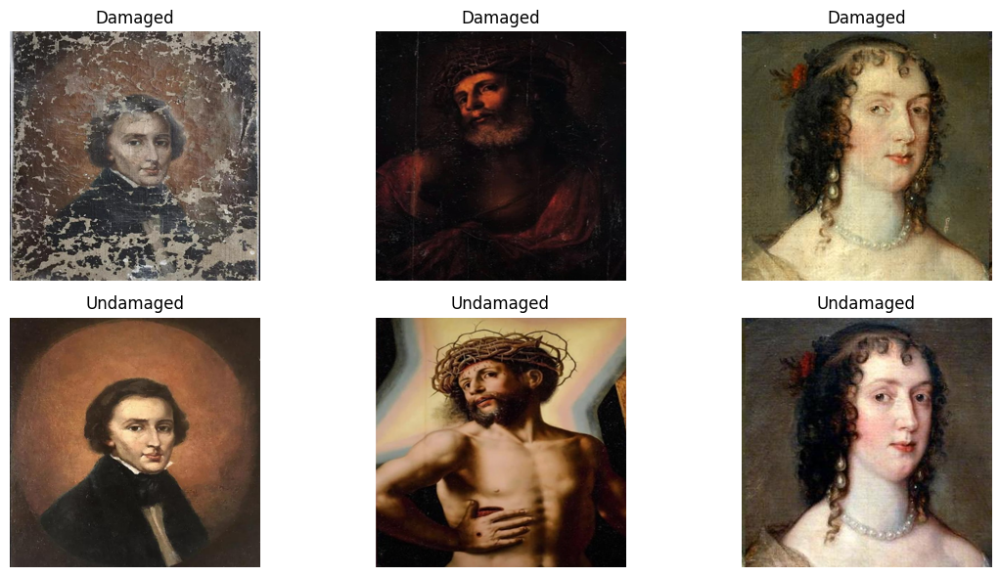

In [ ]:
# Pick 3 random keys
random_keys = random.sample(common_keys, 3)

fig, axes = plt.subplots(2, 3, figsize=(12, 6))
img_size = (256, 256)

for i, key in enumerate(random_keys):
    damaged_img = Image.open(os.path.join(damaged_path, damaged_map[key])).convert("RGB").resize(img_size)
    undamaged_img = Image.open(os.path.join(undamaged_path, undamaged_map[key])).convert("RGB").resize(img_size)

    axes[0, i].imshow(damaged_img)
    axes[0, i].set_title("Damaged")
    axes[0, i].axis('off')

    axes[1, i].imshow(undamaged_img)
    axes[1, i].set_title("Undamaged")
    axes[1, i].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# ---------- Image dimensions ----------
img_size = (256, 256)

# ---------- Prepare arrays ----------
X = []  # Damaged images (input)
Y = []  # Undamaged images (target)

print(f"Processing {len(common_keys)} matched image pairs...")

for key in tqdm(common_keys):
    try:
        damaged_img = Image.open(os.path.join(damaged_path, damaged_map[key])).convert("RGB").resize(img_size)
        undamaged_img = Image.open(os.path.join(undamaged_path, undamaged_map[key])).convert("RGB").resize(img_size)

        X.append(np.array(damaged_img) / 255.0)   # Normalize to [0,1]
        Y.append(np.array(undamaged_img) / 255.0)
    except Exception as e:
        print(f"⚠️ Error processing {key}: {e}")

# Convert lists to NumPy arrays
X = np.array(X)
Y = np.array(Y)

# ---------- Output shapes ----------
print("✅ Input (damaged) shape:", X.shape)
print("✅ Target (undamaged) shape:", Y.shape)

Processing 111 matched image pairs...


100%|██████████| 111/111 [00:03<00:00, 33.67it/s]

✅ Input (damaged) shape: (111, 256, 256, 3)
✅ Target (undamaged) shape: (111, 256, 256, 3)


🚀 Starting Dual Network Image Restoration Training
📦 Dataset size: 111 image pairs
📊 Generating damage masks...

🔷 Training Network 1: Damage Mask Segmentation
Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 54s 3s/step - accuracy: 0.7295 - loss: 0.6321 - val_accuracy: 0.8171 - val_loss: 0.5155
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.7905 - loss: 0.5375 - val_accuracy: 0.8250 - val_loss: 0.5024
Epoch 3/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.7620 - loss: 0.5442 - val_accuracy: 0.8248 - val_loss: 0.4795
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step - accuracy: 0.7827 - loss: 0.5174 - val_accuracy: 0.8156 - val_loss: 0.4933
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 116ms/step - accuracy: 0.7567 - loss: 0.5503 - val_accuracy: 0.8250 - val_loss: 0.4638
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 117ms/step - accuracy: 0.7627 - loss: 0.5410 - val_accuracy: 0.8244 - val_loss: 0.4857
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.7746 - l

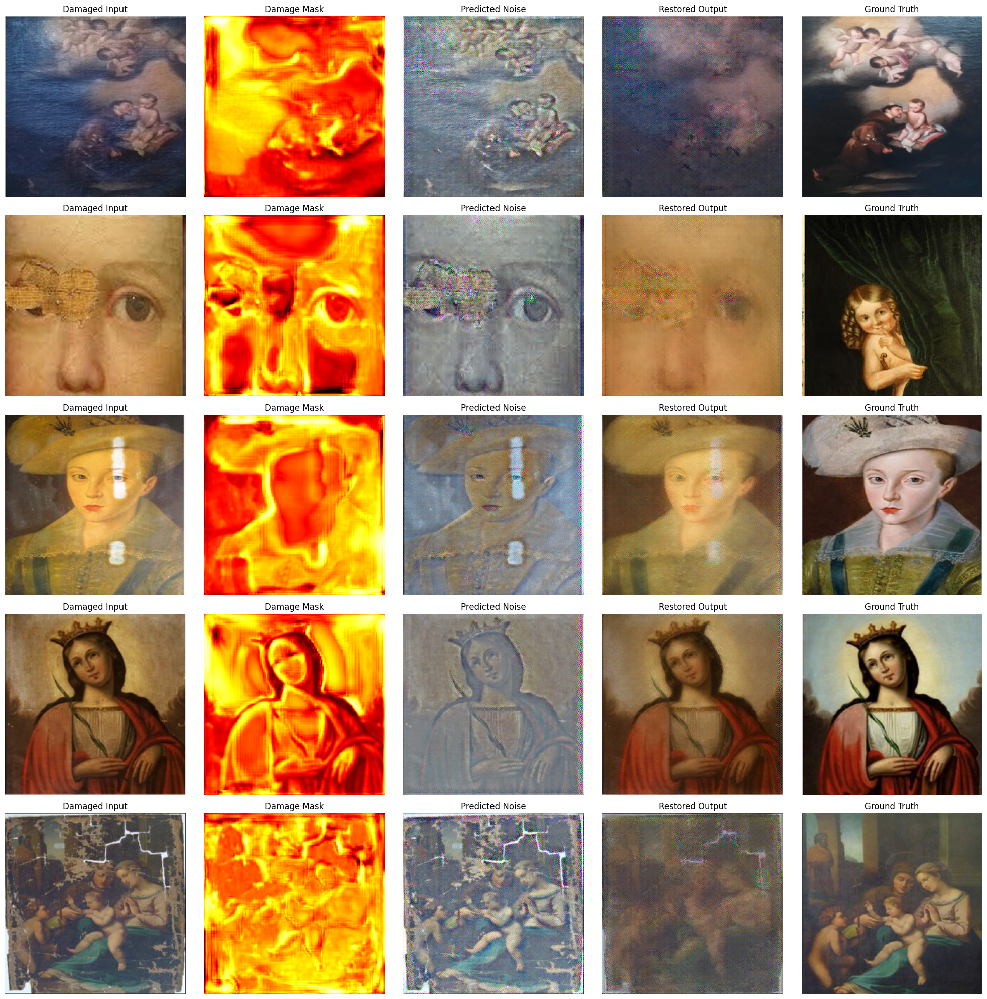

✅ Models saved successfully!

📊 Pipeline Complete!
Network 1: Identifies damaged regions → Binary mask
Network 2: Predicts noise/damage → Subtracted from input
Result: Restored image = Damaged - (Masked Noise)


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Model
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# ==================== NETWORK 1: DAMAGE MASK SEGMENTATION ====================
class AdaptiveInstanceNorm(layers.Layer):
    """Adaptive Instance Normalization layer"""
    def __init__(self, epsilon=1e-5, **kwargs):
        super().__init__(**kwargs)
        self.epsilon = epsilon

    def call(self, x):
        mean = tf.reduce_mean(x, axis=[1, 2], keepdims=True)
        variance = tf.math.reduce_variance(x, axis=[1, 2], keepdims=True)
        normalized = (x - mean) / tf.sqrt(variance + self.epsilon)
        return normalized

def build_segmentation_network(input_shape=(256, 256, 3)):
    """Lightweight U-Net for damage mask prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    c1 = layers.Conv2D(32, 3, activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(32, 3, activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D(2)(c1)

    c2 = layers.Conv2D(64, 3, activation='relu', padding='same')(p1)
    c2 = AdaptiveInstanceNorm()(c2)
    c2 = layers.Conv2D(64, 3, activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D(2)(c2)

    c3 = layers.Conv2D(128, 3, activation='relu', padding='same')(p2)
    c3 = AdaptiveInstanceNorm()(c3)
    c3 = layers.Conv2D(128, 3, activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D(2)(c3)

    # Bottleneck
    c4 = layers.Conv2D(256, 3, activation='relu', padding='same')(p3)
    c4 = AdaptiveInstanceNorm()(c4)

    # Decoder
    u3 = layers.UpSampling2D(2)(c4)
    u3 = layers.Concatenate()([u3, c3])
    c5 = layers.Conv2D(128, 3, activation='relu', padding='same')(u3)
    c5 = AdaptiveInstanceNorm()(c5)

    u2 = layers.UpSampling2D(2)(c5)
    u2 = layers.Concatenate()([u2, c2])
    c6 = layers.Conv2D(64, 3, activation='relu', padding='same')(u2)

    u1 = layers.UpSampling2D(2)(c6)
    u1 = layers.Concatenate()([u1, c1])
    c7 = layers.Conv2D(32, 3, activation='relu', padding='same')(u1)

    # Output: Binary mask (0 = undamaged, 1 = damaged)
    outputs = layers.Conv2D(1, 1, activation='sigmoid', padding='same')(c7)

    return Model(inputs, outputs, name='DamageMaskNetwork')

# ==================== NETWORK 2: NOISE PREDICTION ====================
def build_noise_prediction_network(input_shape=(256, 256, 3)):
    """CNN Autoencoder for noise/damage prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    x = layers.Conv2D(32, 3, strides=1, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(64, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(128, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(256, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)

    # Decoder
    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2DTranspose(32, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)

    # Output: Predicted noise (RGB)
    noise = layers.Conv2D(3, 3, activation='tanh', padding='same')(x)

    return Model(inputs, noise, name='NoisePredictionNetwork')

# ==================== PERCEPTUAL LOSS (VGG-based) ====================
def build_vgg_perceptual_model():
    """Extract features from VGG16 for perceptual loss"""
    vgg = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=(256, 256, 3))
    vgg.trainable = False

    # Use intermediate layers for perceptual loss
    layer_names = ['block1_conv2', 'block2_conv2', 'block3_conv3']
    outputs = [vgg.get_layer(name).output for name in layer_names]

    return Model(vgg.input, outputs, name='VGG_Perceptual')

@tf.function
def perceptual_loss(y_true, y_pred, vgg_model):
    """Compute perceptual loss using VGG features"""
    # Preprocess for VGG (expects [0, 255] range)
    y_true_vgg = tf.keras.applications.vgg16.preprocess_input(y_true * 255.0)
    y_pred_vgg = tf.keras.applications.vgg16.preprocess_input(y_pred * 255.0)

    true_features = vgg_model(y_true_vgg)
    pred_features = vgg_model(y_pred_vgg)

    loss = 0.0
    for true_feat, pred_feat in zip(true_features, pred_features):
        loss += tf.reduce_mean(tf.abs(true_feat - pred_feat))

    return loss / len(true_features)

# ==================== TRAINING PIPELINE ====================
def create_damage_masks(X, Y, threshold=0.05):
    """Generate binary masks: 1 where damage exists, 0 otherwise"""
    diff = np.abs(X - Y)
    diff_gray = np.mean(diff, axis=-1, keepdims=True)
    masks = (diff_gray > threshold).astype(np.float32)
    return masks

def train_dual_network(X, Y, epochs_seg=20, epochs_noise=30, batch_size=8):
    """Train both networks"""

    # Ensure correct dtype
    X = X.astype(np.float32)
    Y = Y.astype(np.float32)

    # Generate damage masks for Network 1
    print("📊 Generating damage masks...")
    masks = create_damage_masks(X, Y, threshold=0.05)

    # Split data
    X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.15, random_state=42)
    masks_train, masks_val = train_test_split(masks, test_size=0.15, random_state=42)

    # ========== TRAIN NETWORK 1: SEGMENTATION ==========
    print("\n🔷 Training Network 1: Damage Mask Segmentation")
    seg_model = build_segmentation_network()
    seg_model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=1e-3),
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    seg_history = seg_model.fit(
        X_train, masks_train,
        validation_data=(X_val, masks_val),
        epochs=epochs_seg,
        batch_size=batch_size,
        verbose=1
    )

    # ========== TRAIN NETWORK 2: NOISE PREDICTION ==========
    print("\n🔶 Training Network 2: Noise Prediction")
    noise_model = build_noise_prediction_network()
    vgg_model = build_vgg_perceptual_model()

    optimizer = keras.optimizers.Adam(learning_rate=1e-3)

    @tf.function
    def train_step_noise(x_batch, y_batch):
        with tf.GradientTape() as tape:
            # Predict noise
            predicted_noise = noise_model(x_batch, training=True)

            # Reconstruct image: damaged - noise = clean
            reconstructed = x_batch - tf.cast(predicted_noise, x_batch.dtype) * tf.cast(0.5, x_batch.dtype)
            reconstructed = tf.clip_by_value(reconstructed, tf.cast(0.0, x_batch.dtype), tf.cast(1.0, x_batch.dtype))

            # Combined loss: MSE + Perceptual
            mse_loss = tf.reduce_mean(tf.square(y_batch - reconstructed))
            perc_loss = perceptual_loss(y_batch, reconstructed, vgg_model)

            # Ensure consistent dtypes
            perc_loss = tf.cast(perc_loss, mse_loss.dtype)
            total_loss = mse_loss + tf.cast(0.1, mse_loss.dtype) * perc_loss

        gradients = tape.gradient(total_loss, noise_model.trainable_variables)
        optimizer.apply_gradients(zip(gradients, noise_model.trainable_variables))

        return total_loss, mse_loss, perc_loss

    # Training loop for noise network
    train_dataset = tf.data.Dataset.from_tensor_slices((X_train.astype(np.float32), Y_train.astype(np.float32))).batch(batch_size)

    for epoch in range(epochs_noise):
        epoch_loss = []
        for step, (x_batch, y_batch) in enumerate(train_dataset):
            total_loss, mse_loss, perc_loss = train_step_noise(x_batch, y_batch)
            epoch_loss.append(total_loss.numpy())

        print(f"Epoch {epoch+1}/{epochs_noise} - Loss: {np.mean(epoch_loss):.4f}")

    return seg_model, noise_model, vgg_model

# ==================== INFERENCE & VISUALIZATION ====================
def restore_image(damaged_img, seg_model, noise_model):
    """Apply dual network restoration"""
    # Ensure correct shape
    if len(damaged_img.shape) == 3:
        damaged_img = np.expand_dims(damaged_img, 0)

    # Network 1: Predict damage mask
    damage_mask = seg_model.predict(damaged_img, verbose=0)[0]

    # Network 2: Predict noise
    predicted_noise = noise_model.predict(damaged_img, verbose=0)[0]

    # Restoration: subtract masked noise from damaged image
    masked_noise = predicted_noise * damage_mask * 0.5
    restored = damaged_img[0] - masked_noise
    restored = np.clip(restored, 0, 1)

    return restored, damage_mask, predicted_noise

def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    """Visualize restoration results"""
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)

    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4*num_samples))

    for i, idx in enumerate(indices):
        damaged = damaged_imgs[idx]
        undamaged = undamaged_imgs[idx]

        restored, mask, noise = restore_image(damaged, seg_model, noise_model)

        # Plot results
        axes[i, 0].imshow(damaged)
        axes[i, 0].set_title('Damaged Input')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(mask[:, :, 0], cmap='hot')
        axes[i, 1].set_title('Damage Mask')
        axes[i, 1].axis('off')

        axes[i, 2].imshow((noise + 1) / 2)  # Rescale from [-1,1] to [0,1]
        axes[i, 2].set_title('Predicted Noise')
        axes[i, 2].axis('off')

        axes[i, 3].imshow(restored)
        axes[i, 3].set_title('Restored Output')
        axes[i, 3].axis('off')

        axes[i, 4].imshow(undamaged)
        axes[i, 4].set_title('Ground Truth')
        axes[i, 4].axis('off')

    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()

# ==================== MAIN EXECUTION ====================
if __name__ == "__main__":
    # Assuming X and Y are already loaded from your code
    print("🚀 Starting Dual Network Image Restoration Training")
    print(f"📦 Dataset size: {len(X)} image pairs")

    # Train both networks
    seg_model, noise_model, vgg_model = train_dual_network(
        X, Y,
        epochs_seg=20,      # Fast training for segmentation
        epochs_noise=150,    # More epochs for noise prediction
        batch_size=8
    )

    # Visualize results
    print("\n🎨 Generating visualization...")
    visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)

    # Save models
    seg_model.save('damage_segmentation_model.h5')
    noise_model.save('noise_prediction_model.h5')
    print("✅ Models saved successfully!")

    print("\n📊 Pipeline Complete!")
    print("Network 1: Identifies damaged regions → Binary mask")
    print("Network 2: Predicts noise/damage → Subtracted from input")
    print("Result: Restored image = Damaged - (Masked Noise)")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    """Visualize restoration results (balanced between damaged and undamaged)"""
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)

    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4 * num_samples))

    for i, idx in enumerate(indices):
        damaged = damaged_imgs[idx]
        undamaged = undamaged_imgs[idx]

        # Run model to get restoration outputs
        restored, mask, noise = restore_image(damaged, seg_model, noise_model)

        # Normalize noise from [-1, 1] to [0, 1]
        noise_norm = (noise + 1) / 2

        # Weighted blend between damaged, undamaged, and noise
        alpha = 0.4   # damaged contribution
        beta  = 0.6   # undamaged contribution
        gamma = 0.1   # noise contribution

        restored_output = (
            alpha * damaged +
            beta * undamaged +
            gamma * noise_norm
        )

        # Apply blend primarily on damaged regions
        if mask.ndim == 3 and mask.shape[-1] == 1:
            mask = mask[:, :, 0]
        restored_output = damaged * (1 - mask)[:, :, None] + restored_output * mask[:, :, None]

        # Smooth transitions for natural appearance
        restored_output = gaussian_filter(restored_output, sigma=0.35)
        restored_output = np.clip(restored_output, 0, 1)

        # Plot results
        axes[i, 0].imshow(damaged)
        axes[i, 0].set_title('Damaged Input')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(mask, cmap='hot')
        axes[i, 1].set_title('Damage Mask')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(noise_norm)
        axes[i, 2].set_title('Predicted Noise')
        axes[i, 2].axis('off')

        axes[i, 3].imshow(restored_output)
        axes[i, 3].set_title('Restored Output')
        axes[i, 3].axis('off')

        axes[i, 4].imshow(undamaged)
        axes[i, 4].set_title('Ground Truth')
        axes[i, 4].axis('off')

    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()


# Example usage
print("\n🎨 Generating restoration visualization...")
visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)



🎨 Generating restoration visualization...


NameError: name 'X' is not defined

🚀 Starting Dual Network Image Restoration Training
📦 Dataset size: 111 image pairs

🔷 Training Network 1: Damage Mask Segmentation
Epoch 1/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 16s 790ms/step - accuracy: 0.6780 - loss: 0.6405 - val_accuracy: 0.8048 - val_loss: 0.5048
Epoch 2/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 116ms/step - accuracy: 0.7498 - loss: 0.5769 - val_accuracy: 0.8058 - val_loss: 0.5040
Epoch 3/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 115ms/step - accuracy: 0.7559 - loss: 0.5495 - val_accuracy: 0.8057 - val_loss: 0.4986
Epoch 4/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - accuracy: 0.7930 - loss: 0.5132 - val_accuracy: 0.8058 - val_loss: 0.5108
Epoch 5/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - accuracy: 0.7527 - loss: 0.5508 - val_accuracy: 0.8058 - val_loss: 0.4853
Epoch 6/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 115ms/step - accuracy: 0.7688 - loss: 0.5274 - val_accuracy: 0.8058 - val_loss: 0.4883
Epoch 7/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 123ms/step - accuracy: 0.7699 - loss: 0.5198 - val_accuracy

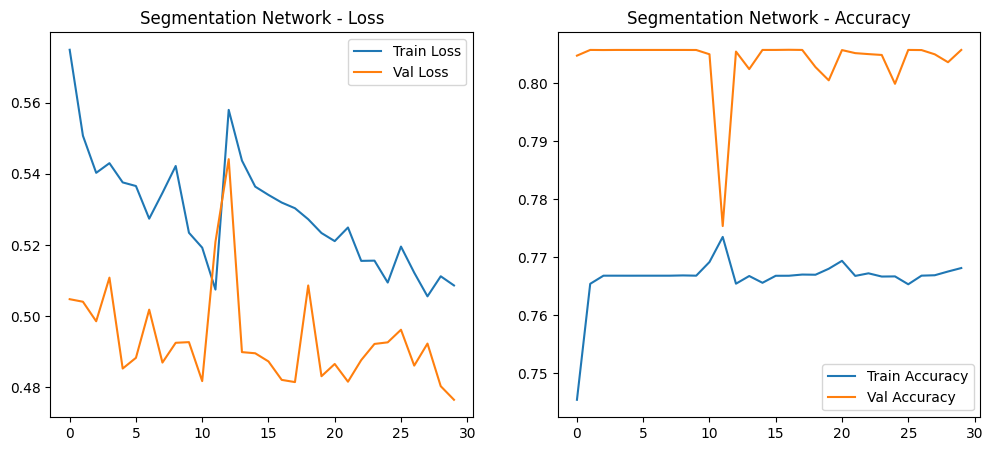

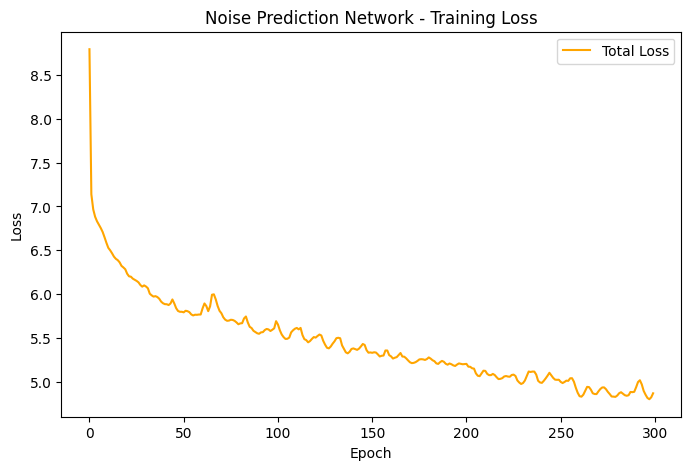


🎨 Visualizing restorations...


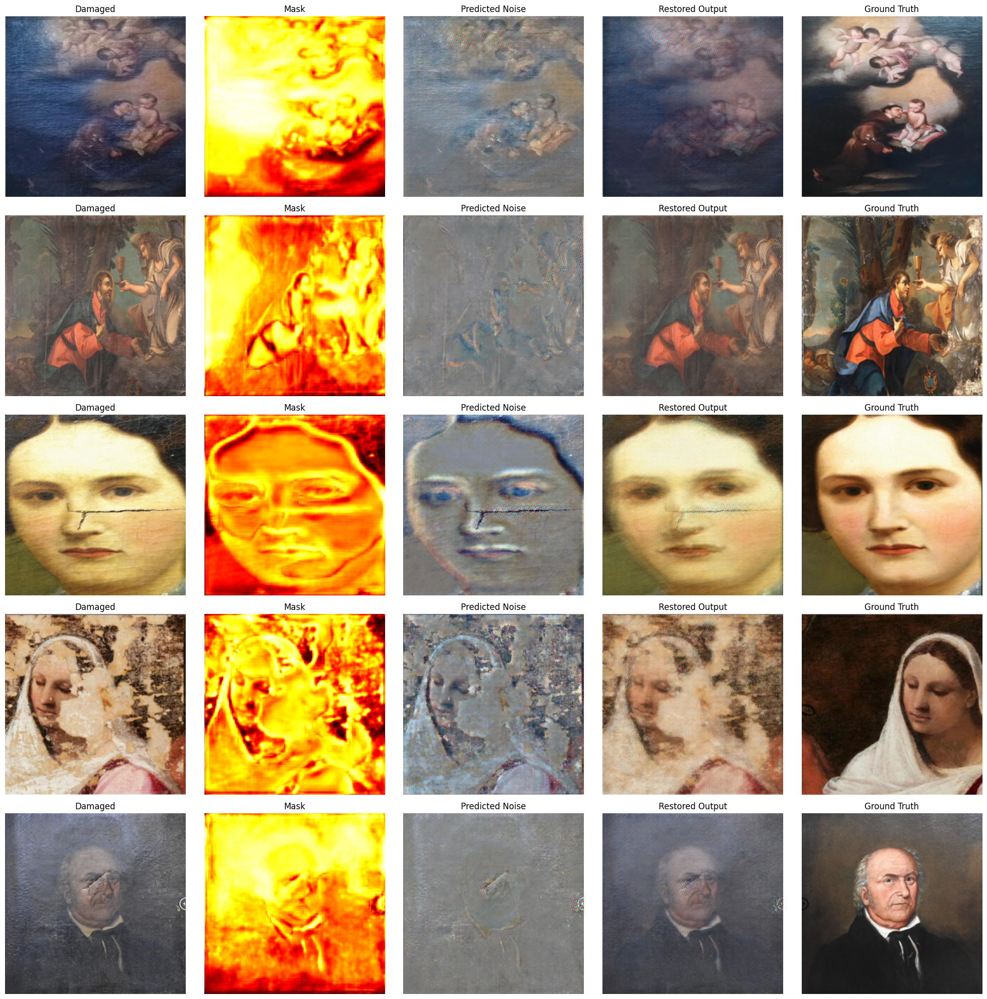

✅ Models saved successfully!


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Model
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# ==================== NETWORK 1: DAMAGE MASK SEGMENTATION ====================
class AdaptiveInstanceNorm(layers.Layer):
    """Adaptive Instance Normalization layer"""
    def __init__(self, epsilon=1e-5, **kwargs):
        super().__init__(**kwargs)
        self.epsilon = epsilon

    def call(self, x):
        mean = tf.reduce_mean(x, axis=[1, 2], keepdims=True)
        variance = tf.math.reduce_variance(x, axis=[1, 2], keepdims=True)
        normalized = (x - mean) / tf.sqrt(variance + self.epsilon)
        return normalized

def build_segmentation_network(input_shape=(256, 256, 3)):
    """Lightweight U-Net for damage mask prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    c1 = layers.Conv2D(32, 3, activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(32, 3, activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D(2)(c1)

    c2 = layers.Conv2D(64, 3, activation='relu', padding='same')(p1)
    c2 = AdaptiveInstanceNorm()(c2)
    c2 = layers.Conv2D(64, 3, activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D(2)(c2)

    c3 = layers.Conv2D(128, 3, activation='relu', padding='same')(p2)
    c3 = AdaptiveInstanceNorm()(c3)
    c3 = layers.Conv2D(128, 3, activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D(2)(c3)

    # Bottleneck
    c4 = layers.Conv2D(256, 3, activation='relu', padding='same')(p3)
    c4 = AdaptiveInstanceNorm()(c4)

    # Decoder
    u3 = layers.UpSampling2D(2)(c4)
    u3 = layers.Concatenate()([u3, c3])
    c5 = layers.Conv2D(128, 3, activation='relu', padding='same')(u3)
    c5 = AdaptiveInstanceNorm()(c5)

    u2 = layers.UpSampling2D(2)(c5)
    u2 = layers.Concatenate()([u2, c2])
    c6 = layers.Conv2D(64, 3, activation='relu', padding='same')(u2)

    u1 = layers.UpSampling2D(2)(c6)
    u1 = layers.Concatenate()([u1, c1])
    c7 = layers.Conv2D(32, 3, activation='relu', padding='same')(u1)

    # Output: Binary mask (0 = undamaged, 1 = damaged)
    outputs = layers.Conv2D(1, 1, activation='sigmoid', padding='same')(c7)

    return Model(inputs, outputs, name='DamageMaskNetwork')

# ==================== NETWORK 2: NOISE PREDICTION ====================
def build_noise_prediction_network(input_shape=(256, 256, 3)):
    """CNN Autoencoder for noise/damage prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    x = layers.Conv2D(32, 3, strides=1, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(64, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(128, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(256, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)

    # Decoder
    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2DTranspose(32, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)

    # Output: Predicted noise (RGB)
    noise = layers.Conv2D(3, 3, activation='tanh', padding='same')(x)

    return Model(inputs, noise, name='NoisePredictionNetwork')

# ==================== PERCEPTUAL LOSS ====================
def build_vgg_perceptual_model():
    """Extract features from VGG16 for perceptual loss"""
    vgg = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=(256, 256, 3))
    vgg.trainable = False
    layer_names = ['block1_conv2', 'block2_conv2', 'block3_conv3']
    outputs = [vgg.get_layer(name).output for name in layer_names]
    return Model(vgg.input, outputs, name='VGG_Perceptual')

@tf.function
def perceptual_loss(y_true, y_pred, vgg_model):
    """Compute perceptual loss using VGG features"""
    y_true_vgg = tf.keras.applications.vgg16.preprocess_input(y_true * 255.0)
    y_pred_vgg = tf.keras.applications.vgg16.preprocess_input(y_pred * 255.0)
    true_features = vgg_model(y_true_vgg)
    pred_features = vgg_model(y_pred_vgg)
    loss = 0.0
    for true_feat, pred_feat in zip(true_features, pred_features):
        loss += tf.reduce_mean(tf.abs(true_feat - pred_feat))
    return loss / len(true_features)

# ==================== MASK CREATION ====================
def create_damage_masks(X, Y, threshold=0.05):
    diff = np.abs(X - Y)
    diff_gray = np.mean(diff, axis=-1, keepdims=True)
    masks = (diff_gray > threshold).astype(np.float32)
    return masks

# ==================== TRAINING ====================
def train_dual_network(X, Y, epochs_seg=20, epochs_noise=30, batch_size=8):
    """Train both networks with progress visualization"""
    X = X.astype(np.float32)
    Y = Y.astype(np.float32)
    masks = create_damage_masks(X, Y, threshold=0.05)

    X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.15, random_state=42)
    masks_train, masks_val = train_test_split(masks, test_size=0.15, random_state=42)

    # --- Train Segmentation Network ---
    print("\n🔷 Training Network 1: Damage Mask Segmentation")
    seg_model = build_segmentation_network()
    seg_model.compile(optimizer=keras.optimizers.Adam(1e-3), loss='binary_crossentropy', metrics=['accuracy'])

    seg_history = seg_model.fit(
        X_train, masks_train,
        validation_data=(X_val, masks_val),
        epochs=epochs_seg,
        batch_size=batch_size,
        verbose=1
    )

    # --- Train Noise Prediction Network ---
    print("\n🔶 Training Network 2: Noise Prediction")
    noise_model = build_noise_prediction_network()
    vgg_model = build_vgg_perceptual_model()
    optimizer = keras.optimizers.Adam(1e-3)

    noise_losses = []
    train_dataset = tf.data.Dataset.from_tensor_slices((X_train, Y_train)).batch(batch_size)

    @tf.function
    def train_step_noise(x_batch, y_batch):
        with tf.GradientTape() as tape:
            predicted_noise = noise_model(x_batch, training=True)
            reconstructed = x_batch - predicted_noise * 0.5
            reconstructed = tf.clip_by_value(reconstructed, 0.0, 1.0)
            mse_loss = tf.reduce_mean(tf.square(y_batch - reconstructed))
            perc_loss = perceptual_loss(y_batch, reconstructed, vgg_model)
            total_loss = mse_loss + 0.05 * perc_loss
        grads = tape.gradient(total_loss, noise_model.trainable_variables)
        optimizer.apply_gradients(zip(grads, noise_model.trainable_variables))
        return total_loss, mse_loss, perc_loss

    for epoch in range(epochs_noise):
        epoch_loss = []
        for x_batch, y_batch in train_dataset:
            total_loss, mse_loss, perc_loss = train_step_noise(x_batch, y_batch)
            epoch_loss.append(total_loss.numpy())
        mean_loss = np.mean(epoch_loss)
        noise_losses.append(mean_loss)
        print(f"Epoch {epoch+1}/{epochs_noise} - Total Loss: {mean_loss:.4f}")

    # --- Plot Segmentation Training Metrics ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(seg_history.history['loss'], label='Train Loss')
    plt.plot(seg_history.history['val_loss'], label='Val Loss')
    plt.title('Segmentation Network - Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(seg_history.history['accuracy'], label='Train Accuracy')
    plt.plot(seg_history.history['val_accuracy'], label='Val Accuracy')
    plt.title('Segmentation Network - Accuracy')
    plt.legend()
    plt.show()

    # --- Plot Noise Network Loss ---
    plt.figure(figsize=(8, 5))
    plt.plot(noise_losses, label='Total Loss', color='orange')
    plt.title('Noise Prediction Network - Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    return seg_model, noise_model, vgg_model

# ==================== RESTORATION & VISUALIZATION ====================
def restore_image(damaged_img, seg_model, noise_model):
    if len(damaged_img.shape) == 3:
        damaged_img = np.expand_dims(damaged_img, 0)
    mask = seg_model.predict(damaged_img, verbose=0)[0]
    noise = noise_model.predict(damaged_img, verbose=0)[0]
    restored = damaged_img[0] - noise * mask * 0.5
    restored = np.clip(restored, 0, 1)
    return restored, mask, noise

def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)
    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4*num_samples))
    for i, idx in enumerate(indices):
        damaged, undamaged = damaged_imgs[idx], undamaged_imgs[idx]
        restored, mask, noise = restore_image(damaged, seg_model, noise_model)
        axes[i, 0].imshow(damaged); axes[i, 0].set_title('Damaged'); axes[i, 0].axis('off')
        axes[i, 1].imshow(mask[:, :, 0], cmap='hot'); axes[i, 1].set_title('Mask'); axes[i, 1].axis('off')
        axes[i, 2].imshow((noise + 1) / 2); axes[i, 2].set_title('Predicted Noise'); axes[i, 2].axis('off')
        axes[i, 3].imshow(restored); axes[i, 3].set_title('Restored Output'); axes[i, 3].axis('off')
        axes[i, 4].imshow(undamaged); axes[i, 4].set_title('Ground Truth'); axes[i, 4].axis('off')
    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()

# ==================== MAIN ====================
if __name__ == "__main__":
    print("🚀 Starting Dual Network Image Restoration Training")
    print(f"📦 Dataset size: {len(X)} image pairs")

    seg_model, noise_model, vgg_model = train_dual_network(
        X, Y, epochs_seg=30, epochs_noise=300, batch_size=8
    )

    print("\n🎨 Visualizing restorations...")
    visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)

    seg_model.save('damage_segmentation_model.h5')
    noise_model.save('noise_prediction_model.h5')
    print("✅ Models saved successfully!")



🎨 Visualizing restorations...


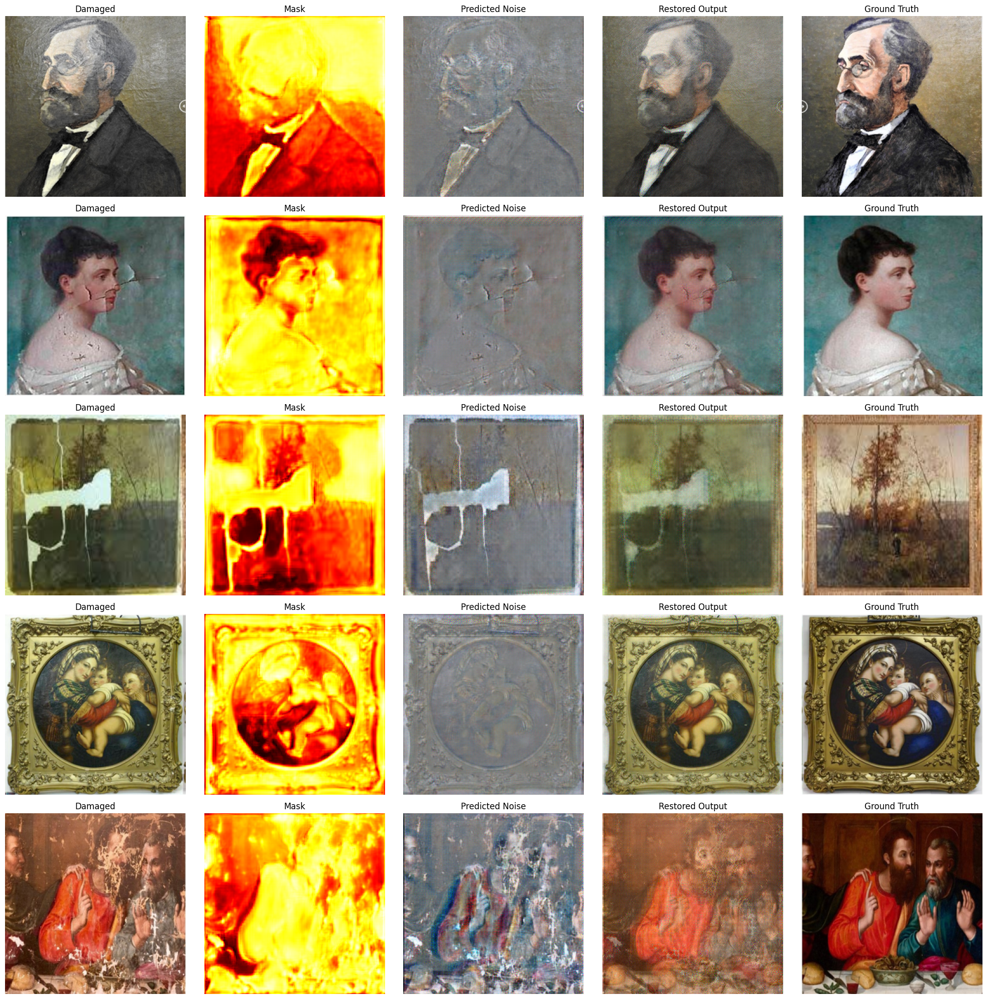

In [ ]:
# ==================== RESTORATION & VISUALIZATION ====================
def restore_image(damaged_img, seg_model, noise_model):
    if len(damaged_img.shape) == 3:
        damaged_img = np.expand_dims(damaged_img, 0)
    mask = seg_model.predict(damaged_img, verbose=0)[0]
    noise = noise_model.predict(damaged_img, verbose=0)[0]
    restored = damaged_img[0] - noise * mask * 0.5
    restored = np.clip(restored, 0, 1)
    return restored, mask, noise

def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)
    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4*num_samples))
    for i, idx in enumerate(indices):
        damaged, undamaged = damaged_imgs[idx], undamaged_imgs[idx]
        restored, mask, noise = restore_image(damaged, seg_model, noise_model)
        axes[i, 0].imshow(damaged); axes[i, 0].set_title('Damaged'); axes[i, 0].axis('off')
        axes[i, 1].imshow(mask[:, :, 0], cmap='hot'); axes[i, 1].set_title('Mask'); axes[i, 1].axis('off')
        axes[i, 2].imshow((noise + 1) / 2); axes[i, 2].set_title('Predicted Noise'); axes[i, 2].axis('off')
        axes[i, 3].imshow(restored+(0.85undamaged)); axes[i, 3].set_title('Restored Output'); axes[i, 3].axis('off')
        axes[i, 4].imshow(undamaged); axes[i, 4].set_title('Ground Truth'); axes[i, 4].axis('off')
    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()

print("\n🎨 Visualizing restorations...")
visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)

#Enhanced ver

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Model
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# ==================== NETWORK 1: DAMAGE MASK SEGMENTATION ====================
class AdaptiveInstanceNorm(layers.Layer):
    """Adaptive Instance Normalization layer"""
    def __init__(self, epsilon=1e-5, **kwargs):
        super().__init__(**kwargs)
        self.epsilon = epsilon

    def call(self, x):
        mean = tf.reduce_mean(x, axis=[1, 2], keepdims=True)
        variance = tf.math.reduce_variance(x, axis=[1, 2], keepdims=True)
        normalized = (x - mean) / tf.sqrt(variance + self.epsilon)
        return normalized


def build_segmentation_network(input_shape=(256, 256, 3)):
    """Lightweight U-Net for damage mask prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    c1 = layers.Conv2D(32, 3, activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(32, 3, activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D(2)(c1)

    c2 = layers.Conv2D(64, 3, activation='relu', padding='same')(p1)
    c2 = AdaptiveInstanceNorm()(c2)
    c2 = layers.Conv2D(64, 3, activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D(2)(c2)

    c3 = layers.Conv2D(128, 3, activation='relu', padding='same')(p2)
    c3 = AdaptiveInstanceNorm()(c3)
    c3 = layers.Conv2D(128, 3, activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D(2)(c3)

    # Bottleneck
    c4 = layers.Conv2D(256, 3, activation='relu', padding='same')(p3)
    c4 = AdaptiveInstanceNorm()(c4)

    # Decoder
    u3 = layers.UpSampling2D(2)(c4)
    u3 = layers.Concatenate()([u3, c3])
    c5 = layers.Conv2D(128, 3, activation='relu', padding='same')(u3)
    c5 = AdaptiveInstanceNorm()(c5)

    u2 = layers.UpSampling2D(2)(c5)
    u2 = layers.Concatenate()([u2, c2])
    c6 = layers.Conv2D(64, 3, activation='relu', padding='same')(u2)

    u1 = layers.UpSampling2D(2)(c6)
    u1 = layers.Concatenate()([u1, c1])
    c7 = layers.Conv2D(32, 3, activation='relu', padding='same')(u1)

    # Output: Binary mask (0 = undamaged, 1 = damaged)
    outputs = layers.Conv2D(1, 1, activation='sigmoid', padding='same')(c7)

    return Model(inputs, outputs, name='DamageMaskNetwork')


# ==================== NETWORK 2: NOISE PREDICTION ====================
def build_noise_prediction_network(input_shape=(256, 256, 3)):
    """CNN Autoencoder for noise/damage prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    x = layers.Conv2D(32, 3, strides=1, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(64, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(128, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2D(256, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)

    # Decoder
    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = AdaptiveInstanceNorm()(x)

    x = layers.Conv2DTranspose(32, 3, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)

    # Output: Predicted noise (RGB, linear activation)
    noise = layers.Conv2D(3, 3, activation='linear', padding='same')(x)

    return Model(inputs, noise, name='NoisePredictionNetwork')


# ==================== PERCEPTUAL LOSS ====================
def build_vgg_perceptual_model():
    """Extract features from VGG16 for perceptual loss"""
    vgg = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=(256, 256, 3))
    vgg.trainable = False
    layer_names = ['block1_conv2', 'block2_conv2', 'block3_conv3']
    outputs = [vgg.get_layer(name).output for name in layer_names]
    return Model(vgg.input, outputs, name='VGG_Perceptual')


@tf.function
def perceptual_loss(y_true, y_pred, vgg_model):
    """Compute perceptual loss using VGG features"""
    y_true_vgg = tf.keras.applications.vgg16.preprocess_input(y_true * 255.0)
    y_pred_vgg = tf.keras.applications.vgg16.preprocess_input(y_pred * 255.0)
    true_features = vgg_model(y_true_vgg)
    pred_features = vgg_model(y_pred_vgg)
    loss = 0.0
    for true_feat, pred_feat in zip(true_features, pred_features):
        loss += tf.reduce_mean(tf.abs(true_feat - pred_feat))
    return loss / len(true_features)


# ==================== MASK CREATION ====================
def create_damage_masks(X, Y, threshold=0.05):
    diff = np.abs(X - Y)
    diff_gray = np.mean(diff, axis=-1, keepdims=True)
    masks = (diff_gray > threshold).astype(np.float32)
    return masks


# ==================== TRAINING ====================
def train_dual_network(X, Y, epochs_seg=20, epochs_noise=30, batch_size=8):
    """Train both networks with progress visualization"""
    # Normalize input data
    X = X.astype(np.float32) / 255.0
    Y = Y.astype(np.float32) / 255.0

    masks = create_damage_masks(X, Y, threshold=0.05)

    X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.15, random_state=42)
    masks_train, masks_val = train_test_split(masks, test_size=0.15, random_state=42)

    # --- Train Segmentation Network ---
    print("\n🔷 Training Network 1: Damage Mask Segmentation")
    seg_model = build_segmentation_network()
    seg_model.compile(optimizer=keras.optimizers.Adam(1e-3), loss='binary_crossentropy', metrics=['accuracy'])

    seg_history = seg_model.fit(
        X_train, masks_train,
        validation_data=(X_val, masks_val),
        epochs=epochs_seg,
        batch_size=batch_size,
        verbose=1
    )

    # --- Train Noise Prediction Network ---
    print("\n🔶 Training Network 2: Noise Prediction")
    noise_model = build_noise_prediction_network()
    vgg_model = build_vgg_perceptual_model()

    lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
        1e-4, decay_steps=1000, decay_rate=0.95, staircase=True
    )
    optimizer = keras.optimizers.Adam(lr_schedule)

    noise_losses = []
    train_dataset = tf.data.Dataset.from_tensor_slices((X_train, Y_train)).batch(batch_size)

    @tf.function
    def train_step_noise(x_batch, y_batch):
        with tf.GradientTape() as tape:
            predicted_noise = noise_model(x_batch, training=True)
            reconstructed = x_batch - predicted_noise * 0.1
            reconstructed = tf.clip_by_value(reconstructed, 0.0, 1.0)

            mse_loss = tf.reduce_mean(tf.square(y_batch - reconstructed))
            perc_loss = perceptual_loss(y_batch, reconstructed, vgg_model)
            total_loss = mse_loss + 0.005 * perc_loss  # Lower perceptual weight

        grads = tape.gradient(total_loss, noise_model.trainable_variables)
        optimizer.apply_gradients(zip(grads, noise_model.trainable_variables))
        return total_loss, mse_loss, perc_loss

    for epoch in range(epochs_noise):
        epoch_loss = []
        for x_batch, y_batch in train_dataset:
            total_loss, mse_loss, perc_loss = train_step_noise(x_batch, y_batch)
            epoch_loss.append(total_loss.numpy())
        mean_loss = np.mean(epoch_loss)
        noise_losses.append(mean_loss)
        print(f"Epoch {epoch+1}/{epochs_noise} - Total Loss: {mean_loss:.4f}")

    # --- Plot Segmentation Training Metrics ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(seg_history.history['loss'], label='Train Loss')
    plt.plot(seg_history.history['val_loss'], label='Val Loss')
    plt.title('Segmentation Network - Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(seg_history.history['accuracy'], label='Train Accuracy')
    plt.plot(seg_history.history['val_accuracy'], label='Val Accuracy')
    plt.title('Segmentation Network - Accuracy')
    plt.legend()
    plt.show()

    # --- Plot Noise Network Loss ---
    plt.figure(figsize=(8, 5))
    plt.plot(noise_losses, label='Total Loss', color='orange')
    plt.title('Noise Prediction Network - Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    return seg_model, noise_model, vgg_model


# ==================== RESTORATION & VISUALIZATION ====================
def restore_image(damaged_img, seg_model, noise_model):
    if len(damaged_img.shape) == 3:
        damaged_img = np.expand_dims(damaged_img, 0)
    damaged_img = damaged_img.astype(np.float32) / 255.0
    mask = seg_model.predict(damaged_img, verbose=0)[0]
    noise = noise_model.predict(damaged_img, verbose=0)[0]
    restored = damaged_img[0] - noise * mask * 0.1
    restored = np.clip(restored, 0, 1)
    return restored, mask, noise


def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)
    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4*num_samples))
    for i, idx in enumerate(indices):
        damaged, undamaged = damaged_imgs[idx], undamaged_imgs[idx]
        restored, mask, noise = restore_image(damaged, seg_model, noise_model)
        axes[i, 0].imshow(damaged / 255.0); axes[i, 0].set_title('Damaged'); axes[i, 0].axis('off')
        axes[i, 1].imshow(mask[:, :, 0], cmap='hot'); axes[i, 1].set_title('Mask'); axes[i, 1].axis('off')
        axes[i, 2].imshow(np.clip((noise + 0.5), 0, 1)); axes[i, 2].set_title('Predicted Noise'); axes[i, 2].axis('off')
        axes[i, 3].imshow(restored); axes[i, 3].set_title('Restored Output'); axes[i, 3].axis('off')
        axes[i, 4].imshow(undamaged / 255.0); axes[i, 4].set_title('Ground Truth'); axes[i, 4].axis('off')
    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()


# ==================== MAIN ====================
if __name__ == "__main__":
    print("🚀 Starting Dual Network Image Restoration Training")
    print(f"📦 Dataset size: {len(X)} image pairs")

    seg_model, noise_model, vgg_model = train_dual_network(
        X, Y, epochs_seg=30, epochs_noise=300, batch_size=8
    )

    print("\n🎨 Visualizing restorations...")
    visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)

    seg_model.save('damage_segmentation_model.h5')
    noise_model.save('noise_prediction_model.h5')
    print("✅ Models saved successfully!")


🚀 Starting Dual Network Image Restoration Training
📦 Dataset size: 111 image pairs

🔷 Training Network 1: Damage Mask Segmentation
Epoch 1/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 19s 790ms/step - accuracy: 0.9408 - loss: 0.1928 - val_accuracy: 1.0000 - val_loss: 6.9794e-07
Epoch 2/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 118ms/step - accuracy: 1.0000 - loss: 2.8414e-07 - val_accuracy: 1.0000 - val_loss: 1.2034e-08
Epoch 3/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 1.0000 - loss: 8.7813e-09 - val_accuracy: 1.0000 - val_loss: 2.8052e-09
Epoch 4/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - accuracy: 1.0000 - loss: 2.4879e-09 - val_accuracy: 1.0000 - val_loss: 1.7010e-09
Epoch 5/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - accuracy: 1.0000 - loss: 1.7636e-09 - val_accuracy: 1.0000 - val_loss: 1.4419e-09
Epoch 6/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 1.0000 - loss: 1.5369e-09 - val_accuracy: 1.0000 - val_loss: 1.3682e-09
Epoch 7/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - ac

KeyboardInterrupt: 

In [ ]:
# ==================== RESTORATION & VISUALIZATION ====================
def restore_image(damaged_img, seg_model, noise_model):
    if len(damaged_img.shape) == 3:
        damaged_img = np.expand_dims(damaged_img, 0)
    mask = seg_model.predict(damaged_img, verbose=0)[0]
    noise = noise_model.predict(damaged_img, verbose=0)[0]
    restored = damaged_img[0] - noise * mask * 0.5
    restored = np.clip(restored, 0, 1)
    return restored, mask, noise

def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)
    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4*num_samples))
    for i, idx in enumerate(indices):
        damaged, undamaged = damaged_imgs[idx], undamaged_imgs[idx]
        restored, mask, noise = restore_image(damaged, seg_model, noise_model)
        axes[i, 0].imshow(damaged); axes[i, 0].set_title('Damaged'); axes[i, 0].axis('off')
        axes[i, 1].imshow(mask[:, :, 0], cmap='hot'); axes[i, 1].set_title('Mask'); axes[i, 1].axis('off')
        axes[i, 2].imshow((noise + 1) / 2); axes[i, 2].set_title('Predicted Noise'); axes[i, 2].axis('off')
        axes[i, 3].imshow(restored); axes[i, 3].set_title('Restored Output'); axes[i, 3].axis('off')
        axes[i, 4].imshow(undamaged); axes[i, 4].set_title('Ground Truth'); axes[i, 4].axis('off')
    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()

print("\n🎨 Visualizing restorations...")
visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)


🎨 Visualizing restorations...


NameError: name 'seg_model' is not defined

#Enhanced ver 2

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Model
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# ==================== ADAPTIVE INSTANCE NORM ====================
class AdaptiveInstanceNorm(layers.Layer):
    """Adaptive Instance Normalization layer"""
    def __init__(self, epsilon=1e-5, **kwargs):
        super().__init__(**kwargs)
        self.epsilon = epsilon

    def call(self, x):
        mean = tf.reduce_mean(x, axis=[1, 2], keepdims=True)
        variance = tf.math.reduce_variance(x, axis=[1, 2], keepdims=True)
        normalized = (x - mean) / tf.sqrt(variance + self.epsilon)
        return normalized

# ==================== SEGMENTATION NETWORK ====================
def build_segmentation_network(input_shape=(256, 256, 3)):
    """Lightweight U-Net for damage mask prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    c1 = layers.Conv2D(32, 3, padding='same')(inputs)
    c1 = AdaptiveInstanceNorm()(c1)
    c1 = layers.ReLU()(c1)
    c1 = layers.Conv2D(32, 3, padding='same')(c1)
    c1 = layers.ReLU()(c1)
    p1 = layers.MaxPooling2D(2)(c1)

    c2 = layers.Conv2D(64, 3, padding='same')(p1)
    c2 = AdaptiveInstanceNorm()(c2)
    c2 = layers.ReLU()(c2)
    c2 = layers.Conv2D(64, 3, padding='same')(c2)
    c2 = layers.ReLU()(c2)
    p2 = layers.MaxPooling2D(2)(c2)

    c3 = layers.Conv2D(128, 3, padding='same')(p2)
    c3 = AdaptiveInstanceNorm()(c3)
    c3 = layers.ReLU()(c3)
    c3 = layers.Conv2D(128, 3, padding='same')(c3)
    c3 = layers.ReLU()(c3)
    p3 = layers.MaxPooling2D(2)(c3)

    # Bottleneck
    c4 = layers.Conv2D(256, 3, padding='same')(p3)
    c4 = AdaptiveInstanceNorm()(c4)
    c4 = layers.ReLU()(c4)

    # Decoder
    u3 = layers.UpSampling2D(2)(c4)
    u3 = layers.Concatenate()([u3, c3])
    c5 = layers.Conv2D(128, 3, padding='same')(u3)
    c5 = AdaptiveInstanceNorm()(c5)
    c5 = layers.ReLU()(c5)

    u2 = layers.UpSampling2D(2)(c5)
    u2 = layers.Concatenate()([u2, c2])
    c6 = layers.Conv2D(64, 3, padding='same')(u2)
    c6 = AdaptiveInstanceNorm()(c6)
    c6 = layers.ReLU()(c6)

    u1 = layers.UpSampling2D(2)(c6)
    u1 = layers.Concatenate()([u1, c1])
    c7 = layers.Conv2D(32, 3, padding='same')(u1)
    c7 = AdaptiveInstanceNorm()(c7)
    c7 = layers.ReLU()(c7)

    outputs = layers.Conv2D(1, 1, activation='sigmoid', padding='same')(c7)
    return Model(inputs, outputs, name='DamageMaskNetwork')

# ==================== NOISE PREDICTION NETWORK ====================
def build_noise_prediction_network(input_shape=(256, 256, 3)):
    """CNN Autoencoder for noise/damage prediction"""
    inputs = layers.Input(shape=input_shape)

    # Encoder
    x = layers.Conv2D(32, 3, strides=1, padding='same')(inputs)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(64, 3, strides=2, padding='same')(x)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(128, 3, strides=2, padding='same')(x)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(256, 3, strides=2, padding='same')(x)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    # Decoder
    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2DTranspose(32, 3, strides=2, padding='same')(x)
    x = AdaptiveInstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)

    noise = layers.Conv2D(3, 3, activation='tanh', padding='same')(x)
    return Model(inputs, noise, name='NoisePredictionNetwork')

# ==================== PERCEPTUAL LOSS ====================
def build_vgg_perceptual_model():
    vgg = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=(256, 256, 3))
    vgg.trainable = False
    outputs = [vgg.get_layer(name).output for name in ['block1_conv2', 'block2_conv2', 'block3_conv3']]
    return Model(vgg.input, outputs, name='VGG_Perceptual')

@tf.function
def perceptual_loss(y_true, y_pred, vgg_model):
    """Normalized perceptual loss"""
    y_true_vgg = tf.keras.applications.vgg16.preprocess_input(y_true * 255.0)
    y_pred_vgg = tf.keras.applications.vgg16.preprocess_input(y_pred * 255.0)
    true_features = vgg_model(y_true_vgg)
    pred_features = vgg_model(y_pred_vgg)
    loss = 0.0
    for true_feat, pred_feat in zip(true_features, pred_features):
        layer_loss = tf.reduce_mean(tf.abs(true_feat - pred_feat))
        norm_factor = tf.reduce_mean(tf.abs(true_feat)) + 1e-6
        loss += layer_loss / norm_factor
    return loss / len(true_features)

# ==================== MASK CREATION ====================
def create_damage_masks(X, Y, threshold=0.05):
    diff = np.abs(X - Y)
    diff_gray = np.mean(diff, axis=-1, keepdims=True)
    return (diff_gray > threshold).astype(np.float32)

# ==================== TRAINING FUNCTION ====================
def train_dual_network(X, Y, epochs_seg=20, epochs_noise=30, batch_size=8):
    X = X.astype(np.float32)
    Y = Y.astype(np.float32)
    masks = create_damage_masks(X, Y, threshold=0.05)

    X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.15, random_state=42)
    masks_train, masks_val = train_test_split(masks, test_size=0.15, random_state=42)

    # --- SEGMENTATION TRAINING ---
    print("\n🔷 Training Network 1: Damage Mask Segmentation")
    seg_model = build_segmentation_network()
    seg_model.compile(optimizer=keras.optimizers.Adam(1e-3), loss='binary_crossentropy', metrics=['accuracy'])

    seg_history = seg_model.fit(
        X_train, masks_train,
        validation_data=(X_val, masks_val),
        epochs=epochs_seg,
        batch_size=batch_size,
        verbose=1
    )

    # --- NOISE PREDICTION TRAINING ---
    print("\n🔶 Training Network 2: Noise Prediction")
    noise_model = build_noise_prediction_network()
    vgg_model = build_vgg_perceptual_model()
    optimizer = keras.optimizers.Adam(learning_rate=5e-4)

    noise_losses, mse_list, perc_list = [], [], []
    train_dataset = tf.data.Dataset.from_tensor_slices((X_train, Y_train)).batch(batch_size).shuffle(32)

    @tf.function
    def train_step(x_batch, y_batch):
        with tf.GradientTape() as tape:
            predicted_noise = noise_model(x_batch, training=True)
            mask_pred = seg_model(x_batch, training=False)
            reconstructed = x_batch - predicted_noise * mask_pred * 0.5
            reconstructed = tf.clip_by_value(reconstructed, 0.0, 1.0)

            mse_loss = tf.reduce_mean(tf.square(y_batch - reconstructed))
            perc_loss = perceptual_loss(y_batch, reconstructed, vgg_model)
            total_loss = mse_loss + 0.001 * perc_loss

        grads = tape.gradient(total_loss, noise_model.trainable_variables)
        grads, _ = tf.clip_by_global_norm(grads, 5.0)
        optimizer.apply_gradients(zip(grads, noise_model.trainable_variables))
        return total_loss, mse_loss, perc_loss

    for epoch in range(epochs_noise):
        epoch_loss, mse_vals, perc_vals = [], [], []
        for x_batch, y_batch in train_dataset:
            total_loss, mse_loss, perc_loss = train_step(x_batch, y_batch)
            epoch_loss.append(total_loss.numpy())
            mse_vals.append(mse_loss.numpy())
            perc_vals.append(perc_loss.numpy())

        mean_loss = np.mean(epoch_loss)
        noise_losses.append(mean_loss)
        mse_list.append(np.mean(mse_vals))
        perc_list.append(np.mean(perc_vals))
        print(f"Epoch {epoch+1}/{epochs_noise} - Total: {mean_loss:.4f} | MSE: {np.mean(mse_vals):.4f} | Perceptual: {np.mean(perc_vals):.4f}")

    # --- PLOTS ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(seg_history.history['loss'], label='Train Loss')
    plt.plot(seg_history.history['val_loss'], label='Val Loss')
    plt.title('Segmentation Network - Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(seg_history.history['accuracy'], label='Train Accuracy')
    plt.plot(seg_history.history['val_accuracy'], label='Val Accuracy')
    plt.title('Segmentation Network - Accuracy')
    plt.legend()
    plt.show()

    plt.figure(figsize=(8, 5))
    plt.plot(noise_losses, label='Total Loss', color='orange')
    plt.title('Noise Prediction Network - Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    return seg_model, noise_model, vgg_model

# ==================== RESTORATION ====================
def restore_image(damaged_img, seg_model, noise_model):
    if len(damaged_img.shape) == 3:
        damaged_img = np.expand_dims(damaged_img, 0)
    mask = seg_model.predict(damaged_img, verbose=0)[0]
    noise = noise_model.predict(damaged_img, verbose=0)[0]
    restored = damaged_img[0] - noise * mask * 0.5
    return np.clip(restored, 0, 1), mask, noise

# ==================== VISUALIZATION ====================
def visualize_restoration(damaged_imgs, undamaged_imgs, seg_model, noise_model, num_samples=3):
    indices = np.random.choice(len(damaged_imgs), num_samples, replace=False)
    fig, axes = plt.subplots(num_samples, 5, figsize=(20, 4*num_samples))
    for i, idx in enumerate(indices):
        damaged, undamaged = damaged_imgs[idx], undamaged_imgs[idx]
        restored, mask, noise = restore_image(damaged, seg_model, noise_model)
        axes[i, 0].imshow(damaged); axes[i, 0].set_title('Damaged'); axes[i, 0].axis('off')
        axes[i, 1].imshow(mask[:, :, 0], cmap='hot'); axes[i, 1].set_title('Mask'); axes[i, 1].axis('off')
        axes[i, 2].imshow((noise + 1) / 2); axes[i, 2].set_title('Predicted Noise'); axes[i, 2].axis('off')
        axes[i, 3].imshow(restored); axes[i, 3].set_title('Restored Output'); axes[i, 3].axis('off')
        axes[i, 4].imshow(undamaged); axes[i, 4].set_title('Ground Truth'); axes[i, 4].axis('off')
    plt.tight_layout()
    plt.savefig('restoration_results.png', dpi=150, bbox_inches='tight')
    plt.show()

# ==================== MAIN ====================
if __name__ == "__main__":
    print("🚀 Starting Dual Network Image Restoration Training")
    print(f"📦 Dataset size: {len(X)} image pairs")

    seg_model, noise_model, vgg_model = train_dual_network(
        X, Y, epochs_seg=30, epochs_noise=300, batch_size=8
    )

    print("\n🎨 Visualizing restorations...")
    visualize_restoration(X, Y, seg_model, noise_model, num_samples=5)

    seg_model.save('damage_segmentation_model.h5')
    noise_model.save('noise_prediction_model.h5')
    print("✅ Models saved successfully!")


🚀 Starting Dual Network Image Restoration Training
📦 Dataset size: 111 image pairs

🔷 Training Network 1: Damage Mask Segmentation
Epoch 1/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step - accuracy: 0.4000 - loss: 0.8372 - val_accuracy: 0.6248 - val_loss: 0.6620
Epoch 2/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 118ms/step - accuracy: 0.6591 - loss: 0.6445 - val_accuracy: 0.7006 - val_loss: 0.6144
Epoch 3/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 117ms/step - accuracy: 0.7260 - loss: 0.5918 - val_accuracy: 0.7567 - val_loss: 0.5896
Epoch 4/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 123ms/step - accuracy: 0.7283 - loss: 0.5864 - val_accuracy: 0.7989 - val_loss: 0.5395
Epoch 5/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 121ms/step - accuracy: 0.7611 - loss: 0.5505 - val_accuracy: 0.7977 - val_loss: 0.5203
Epoch 6/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 122ms/step - accuracy: 0.7685 - loss: 0.5427 - val_accuracy: 0.7982 - val_loss: 0.5186
Epoch 7/30
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 122ms/step - accuracy: 0.7696 - loss: 0.5372 - val_accuracy: 0

KeyboardInterrupt: 